# Import Packages

In [1]:
import sys
import os
import numpy as np
import scanpy as sc
import pandas as pd
import anndata as ad
import episcanpy.api as epi
from matplotlib import pyplot as plt

from gff_analyser import gffClasses,gffBuilder

# modules from sctoolbox
from sctoolbox import annotation
import sctoolbox.atac as atac
import sctoolbox.calc_overlap_pct as overlap
from sctoolbox import celltype_annotation

## Set environmental variables

In [2]:
GTF_PATH = '/home/stud2/notebooks/homo_sapiens.104.mainChr.gtf'  # gtf file to use for peaks annotation
#INPUT_PATH = '/home/rstudio/data/anndata'  # path where the h5ad object is saved
WORKING_DIR = '/mnt/workspace_stud/catlas_ref/'
INPUT = WORKING_DIR + 'cellXcCRE/'
OUTPUT_PATH = '/home/rstudio/testdata'  # path where processed adata file can be save
FRAG_FILE = '/home/stud2/test/skin_sun_exposed_SM-IOBHU_rep1_fragments_sorted.bed'
#FRAG_FILE = '/mnt/workspace_stud/catlas_ref/frag/colon_sigmoid_SM-AZPYO_rep1_fragments.bed.gz'  # path to fragments file
BAM_FILE = '/mnt/workspace_stud/jdetlef/ENC-1JKYN-191-SM-JF1O8_snATAC_colon_sigmoid_Rep1.bam'  # path to bam file
H5AD = 'stomach_more_cluster.h5ad'
#H5AD = 'ENC-1JKYN-146-SM-A8CPH_snATAC_esophagus_muscularis_mucosa_Rep1.h5ad'  # name of the h5ad file

## Import H5AD file

In [3]:
adata = epi.read_h5ad(INPUT + H5AD)
adata

FileNotFoundError: [Errno 2] Unable to open file (unable to open file: name = '/mnt/workspace_stud/catlas_ref/cellXcCRE/stomach_more_cluster.h5ad', errno = 2, error message = 'No such file or directory', flags = 0, o_flags = 0)

## Read H5AD from file

In [16]:
adata = epi.read_h5ad("/mnt/workspace_stud/stud3/stomach_more_cluster.h5ad")

## Export created H5AD file

In [ ]:
import hdf5plugin
adata.write_h5ad(
    "out/skin_sunexposed_mapped.h5ad",
    compression=hdf5plugin.FILTERS["zstd"]
)

In [ ]:
epi.pl.violin(adata, [ 'pct_fragments_in_TSS' ])
epi.pl.violin(adata, [ 'n_fragments_in_TSS' ])


## Clean Cells

### Remove Chromosome M

In [17]:
non_m = [name for name in adata.var_names if not name.startswith('chrM')]
adata = adata[:, non_m]
display(adata)

View of AnnData object with n_obs × n_vars = 2547 × 31459
    obs: 'logUMI', 'tsse', 'tissue', 'cell type', 'Life stage', 'closest Cell Ontology term(s)', 'Cell Ontology ID', 'insertsize_count', 'mean_insertsize', 'n_total_fragments', 'n_fragments_in_three_prime_utr', 'pct_fragments_in_three_prime_utr', 'n_fragments_in_stop_codon', 'pct_fragments_in_stop_codon', 'n_fragments_in_peak10', 'pct_fragments_in_peak10', 'n_fragments_in_gene', 'pct_fragments_in_gene', 'n_fragments_in_CDS', 'pct_fragments_in_CDS', 'n_fragments_in_exon', 'pct_fragments_in_exon', 'n_fragments_in_start_codon', 'pct_fragments_in_start_codon', 'n_fragments_in_promotor', 'pct_fragments_in_promotor', 'n_fragments_in_transcrip', 'pct_fragments_in_transcrip', 'n_fragments_in_exon_gene_bodies', 'pct_fragments_in_exon_gene_bodies', 'n_fragments_in_Selenocysteine', 'pct_fragments_in_Selenocysteine', 'n_fragments_in_blacklisted_regions', 'pct_fragments_in_blacklisted_regions', 'n_fragments_in_gene_bodies', 'pct_fragments_in

### Optional: Remove X and Y chromosomes

In [18]:
non_xy = [name for name in adata.var_names if not name.startswith('chrY') | name.startswith('chrX')]
adata = adata[:, non_xy]
display(adata)

View of AnnData object with n_obs × n_vars = 2547 × 31459
    obs: 'logUMI', 'tsse', 'tissue', 'cell type', 'Life stage', 'closest Cell Ontology term(s)', 'Cell Ontology ID', 'insertsize_count', 'mean_insertsize', 'n_total_fragments', 'n_fragments_in_three_prime_utr', 'pct_fragments_in_three_prime_utr', 'n_fragments_in_stop_codon', 'pct_fragments_in_stop_codon', 'n_fragments_in_peak10', 'pct_fragments_in_peak10', 'n_fragments_in_gene', 'pct_fragments_in_gene', 'n_fragments_in_CDS', 'pct_fragments_in_CDS', 'n_fragments_in_exon', 'pct_fragments_in_exon', 'n_fragments_in_start_codon', 'pct_fragments_in_start_codon', 'n_fragments_in_promotor', 'pct_fragments_in_promotor', 'n_fragments_in_transcrip', 'pct_fragments_in_transcrip', 'n_fragments_in_exon_gene_bodies', 'pct_fragments_in_exon_gene_bodies', 'n_fragments_in_Selenocysteine', 'pct_fragments_in_Selenocysteine', 'n_fragments_in_blacklisted_regions', 'pct_fragments_in_blacklisted_regions', 'n_fragments_in_gene_bodies', 'pct_fragments_in

### Remove empty features

In [19]:
# remove cells with empty features
epi.pp.filter_cells(adata, min_features=1)
# remove features with no cells
epi.pp.filter_features(adata, min_cells=1)

# calculate the log of the number of features in each cell
adata.obs['log_nb_features'] = [np.log10(x) for x in adata.obs['nb_features']]
adata

AnnData object with n_obs × n_vars = 2547 × 31459
    obs: 'logUMI', 'tsse', 'tissue', 'cell type', 'Life stage', 'closest Cell Ontology term(s)', 'Cell Ontology ID', 'insertsize_count', 'mean_insertsize', 'n_total_fragments', 'n_fragments_in_three_prime_utr', 'pct_fragments_in_three_prime_utr', 'n_fragments_in_stop_codon', 'pct_fragments_in_stop_codon', 'n_fragments_in_peak10', 'pct_fragments_in_peak10', 'n_fragments_in_gene', 'pct_fragments_in_gene', 'n_fragments_in_CDS', 'pct_fragments_in_CDS', 'n_fragments_in_exon', 'pct_fragments_in_exon', 'n_fragments_in_start_codon', 'pct_fragments_in_start_codon', 'n_fragments_in_promotor', 'pct_fragments_in_promotor', 'n_fragments_in_transcrip', 'pct_fragments_in_transcrip', 'n_fragments_in_exon_gene_bodies', 'pct_fragments_in_exon_gene_bodies', 'n_fragments_in_Selenocysteine', 'pct_fragments_in_Selenocysteine', 'n_fragments_in_blacklisted_regions', 'pct_fragments_in_blacklisted_regions', 'n_fragments_in_gene_bodies', 'pct_fragments_in_gene_bo

#### Binarize and save different layers

In [20]:
epi.pp.binarize(adata)
adata.layers['binary'] = adata.X.copy()

#### Filter by min and max filter

In [21]:
# filter cells which have at least min_features and at most max_features
epi.pp.filter_cells(adata, min_features=150)
epi.pp.filter_cells(adata, max_features=10000)

#### Normalize Data

In [22]:
sc.pp.normalize_total(adata)
adata.layers['normalised'] = adata.X.copy()

# log-normalize
epi.pp.log1p(adata)

#### Calculate PCA and Neighbours

In [23]:
# calculate pca
sc.pp.pca(adata, n_comps=50, svd_solver='arpack', use_highly_variable=False)
# calculate neighbors
sc.pp.neighbors(adata, n_neighbors=15, n_pcs=50, method='umap', metric='euclidean')

In [ ]:
sc.tl.umap(adata, min_dist=0.7, spread=2.0)

### Get all Celltypes that were predicted beforehand

In [ ]:
celltypes = [celltype for celltype in set(adata.obs["SCSA_pred_celltype"]) if type(celltype) == str]
celltypes

### Generate Violinplot for each fragment type for each cell type

T cell


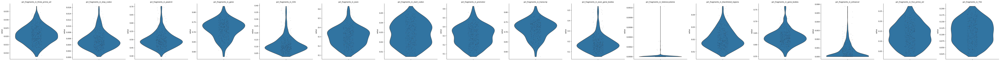

Mesenchymal cell


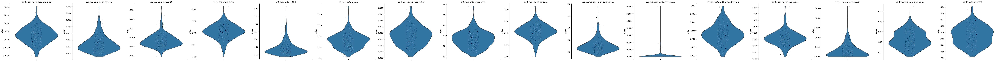

Meiotic prophase fetal germ cell


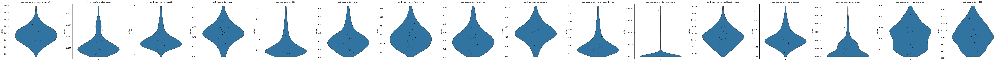

Oogenesis phase fetal germ cell


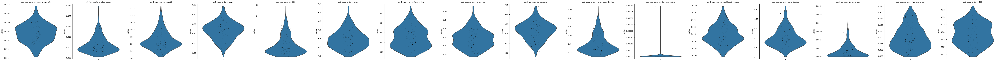

Mesenchymal stem cell


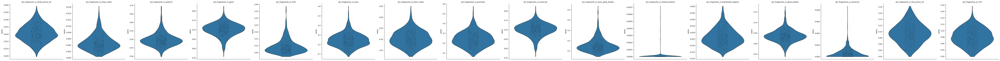

Macrophage


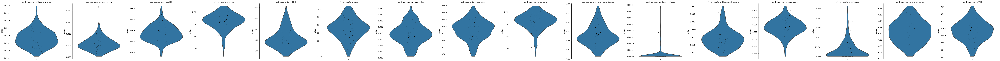

Epithelial cell


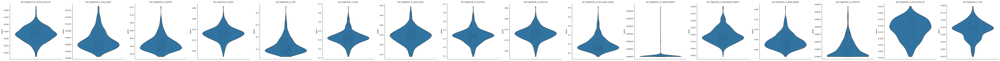

In [124]:
item_list = []
for item in adata.obs:
    if item.startswith('pct_fragments'):
        item_list.append(item)
        
for celltype in celltypes:
    print(celltype)
    sc.pl.violin(filtered[celltype], item_list, multi_panel=True)
    

### Generate Scatterplot for each combination of fragment type

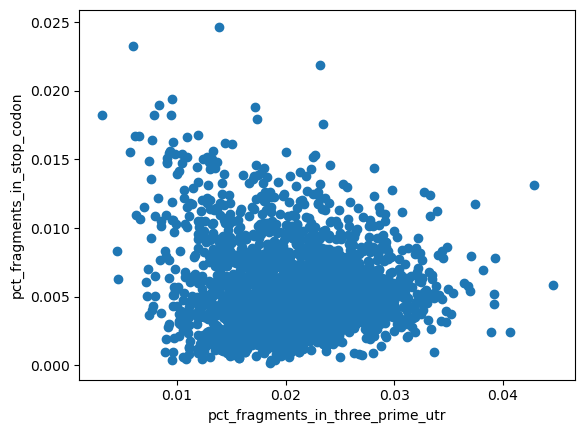

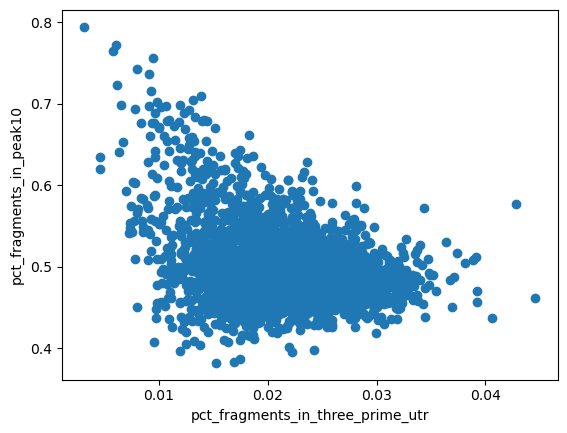

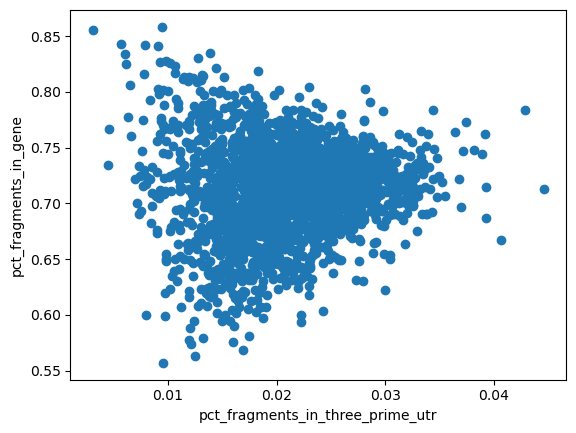

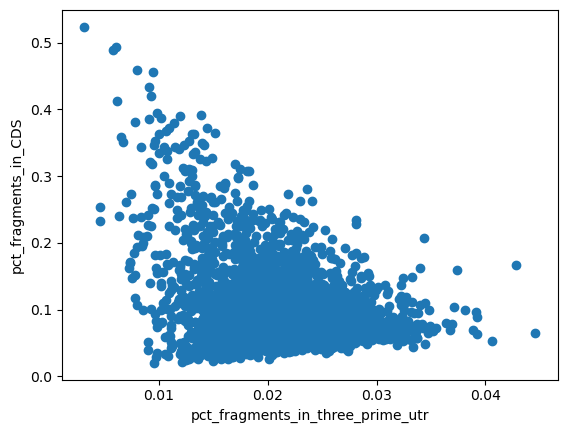

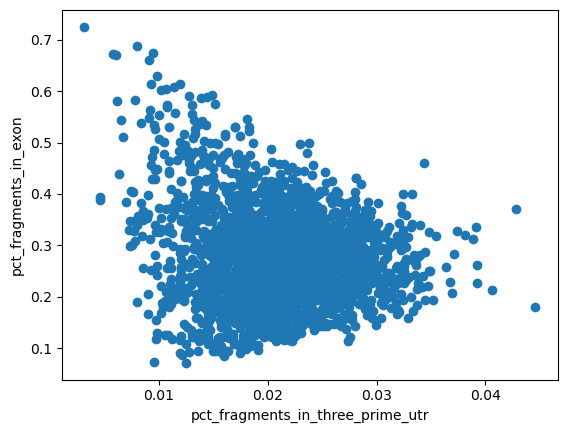

...

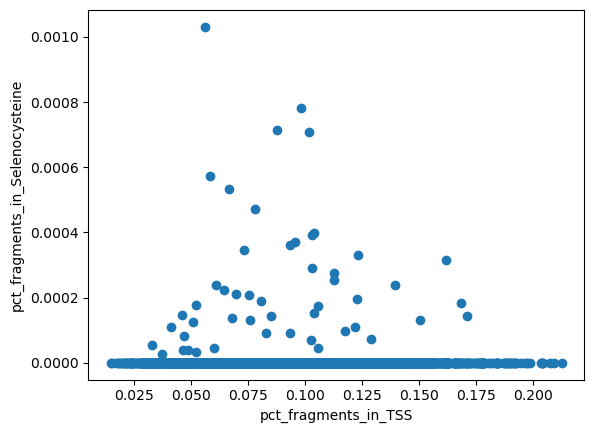

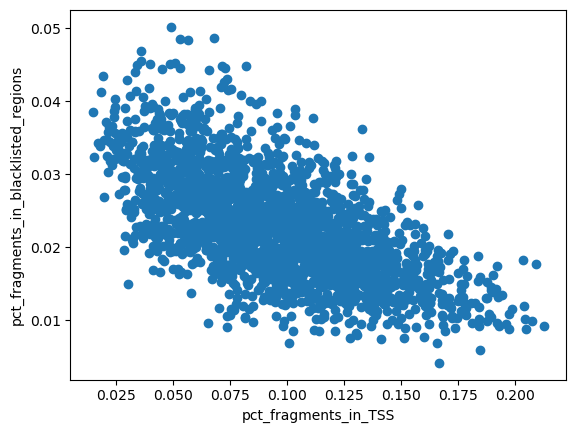

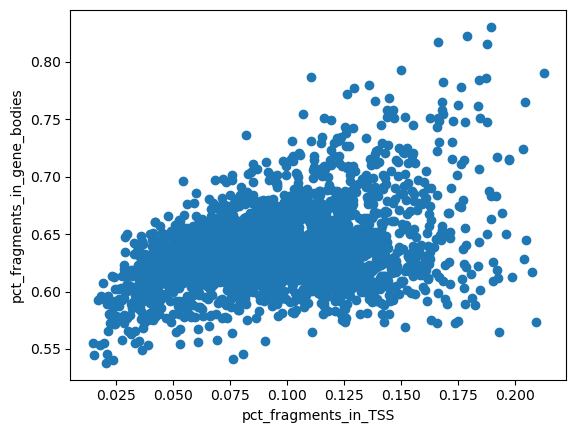

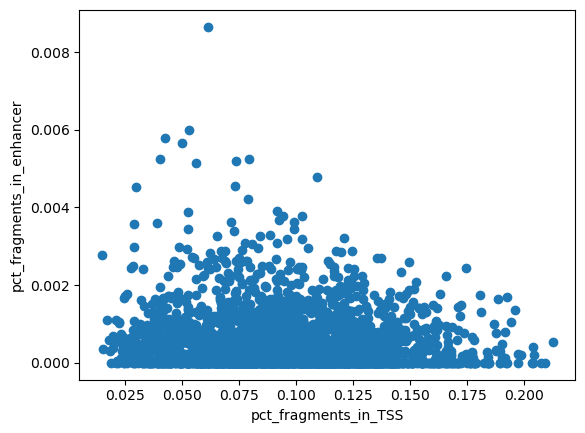

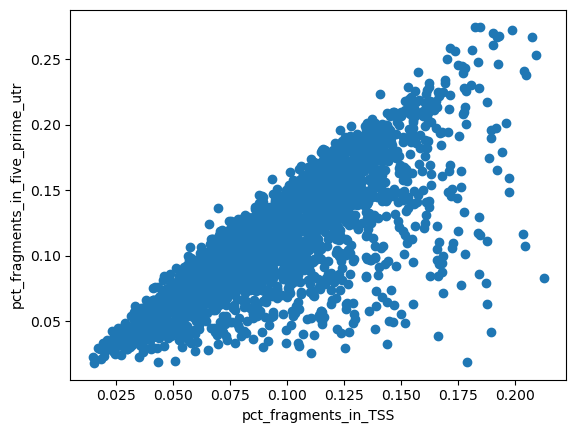

In [102]:
item_list = []

for item in adata.obs:
    if item.startswith('pct_fragments'):
        item_list.append(item)
        
for item in item_list:
    x = adata.obs[item]
    for item2 in item_list:
        y = adata.obs[item2]
        if not item == item2:
            plt.scatter(x, y)
            plt.xlabel(item)
            plt.ylabel(item2)
            plt.show()

In [ ]:
sc.tl.umap(adata, min_dist=0.1, spread=2.0)

### Display Celltype prediction and colored by percentage in each feature

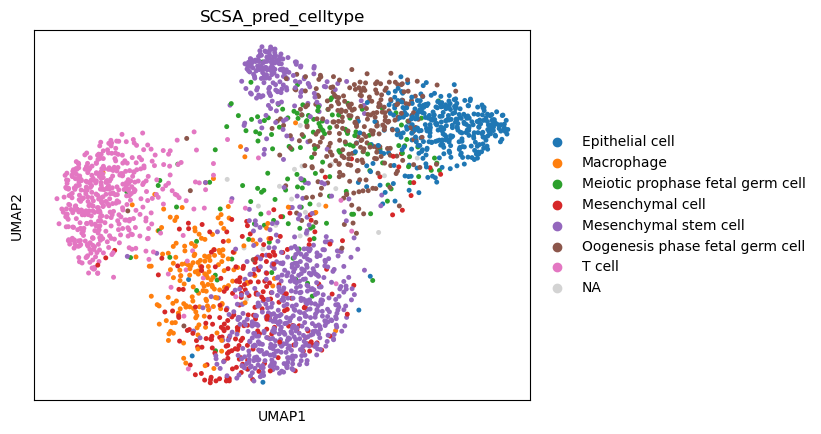

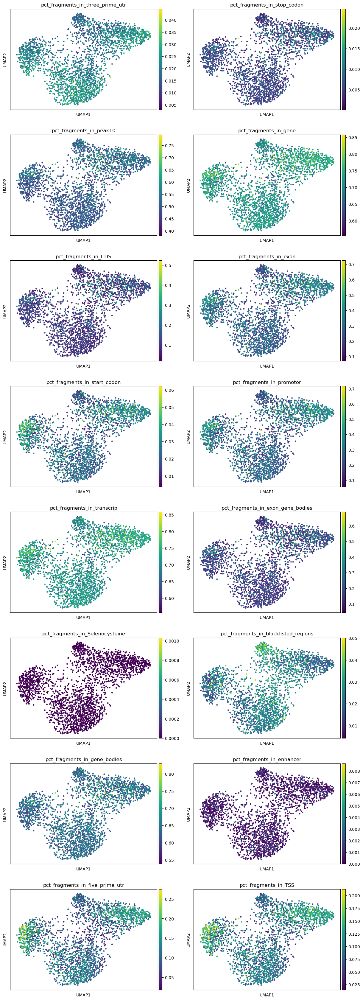

In [106]:
item_list = []
sc.pl.umap(adata, color = 'SCSA_pred_celltype', legend_loc = 'right margin')
for item in adata.obs:
    if item.startswith('pct_fragments'):
        item_list.append(item)
        
sc.pl.umap(adata, color = item_list, ncols=2, legend_loc = 'right margin')

### Display percentage in each feature for every celltype

T cell


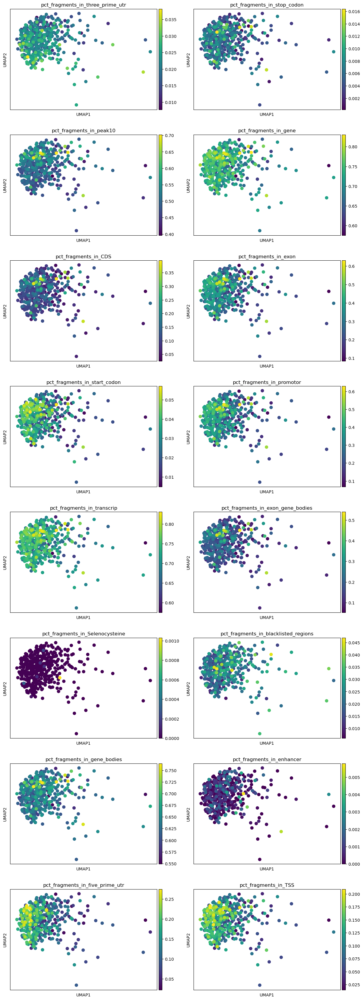

Mesenchymal cell


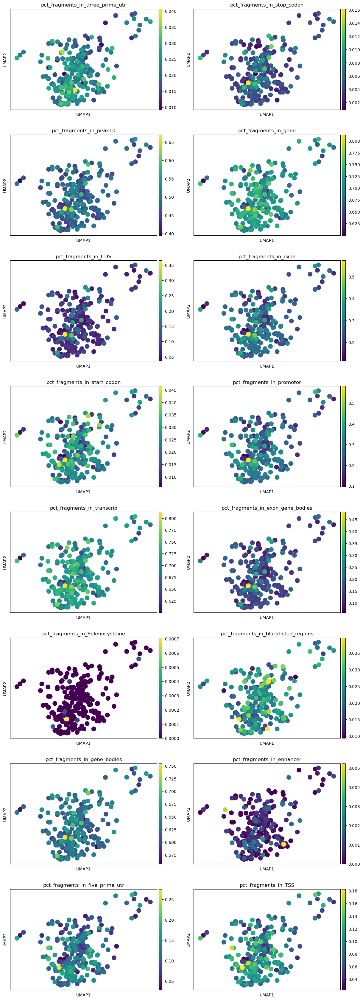

Meiotic prophase fetal germ cell


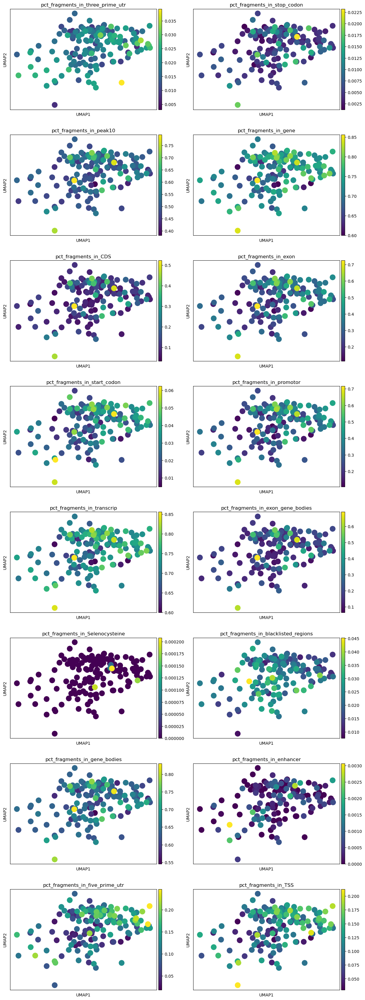

Oogenesis phase fetal germ cell


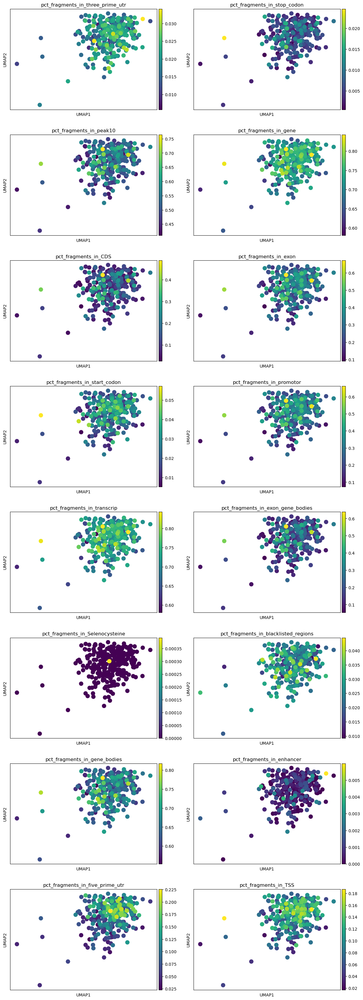

Mesenchymal stem cell


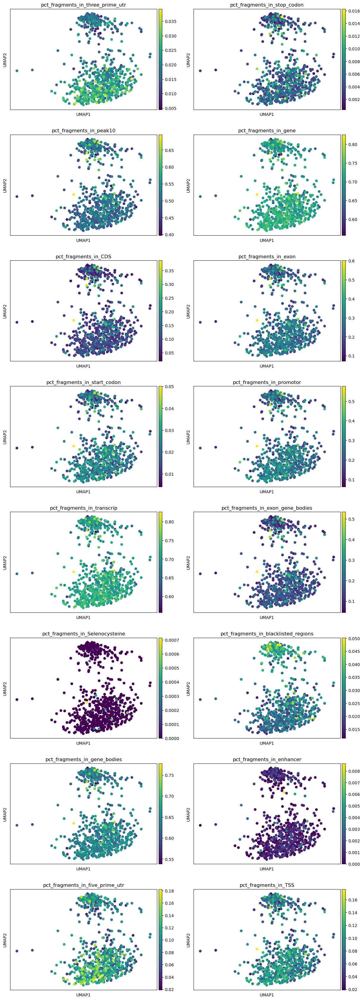

Macrophage


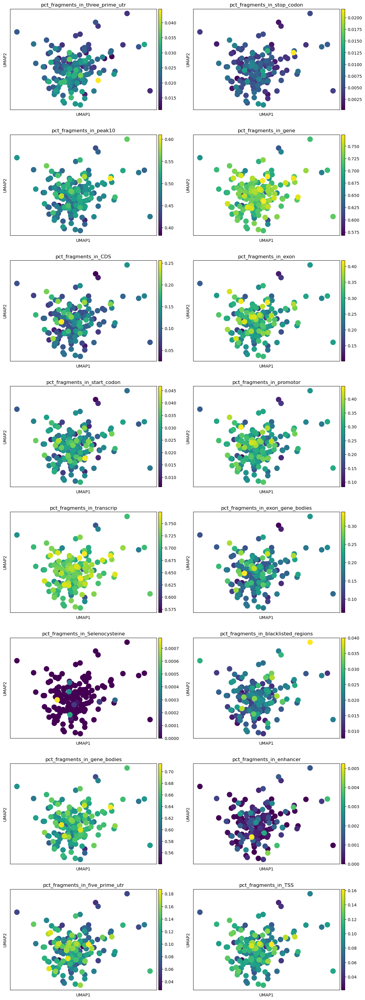

Epithelial cell


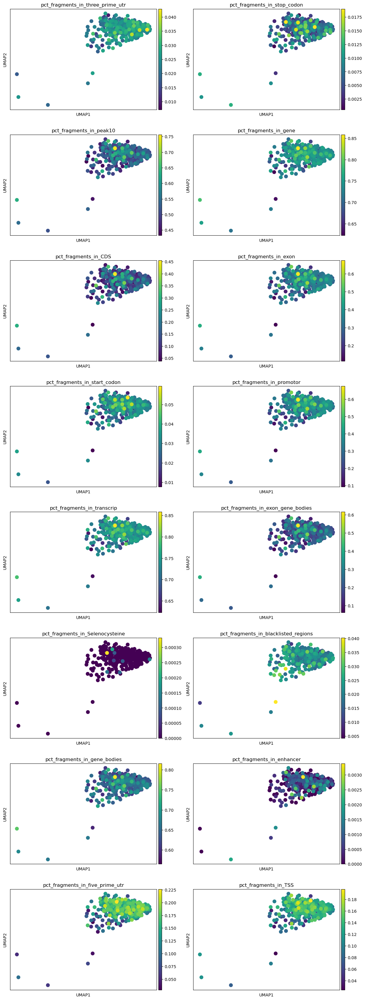

In [125]:
for celltype in t:
    print(celltype)
    sc.pl.umap(filtered[celltype], color = item_list, ncols=2, legend_loc = 'right margin')

# 